In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import scipy.io as sio
from dataclasses import dataclass
from typing import List, Tuple
import os
from dotenv import load_dotenv
load_dotenv()
import tidy3d as td
from tidy3d import web
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
import AutomationModule as AM
from scipy.optimize import curve_fit
from natsort import natsorted


tidy3dAPI = os.environ["API_TIDY3D_KEY"]

In [2]:
slices = np.array([0,0.15,0.3,0.5,0.7])

In [3]:
#store fluxes and max times for SAL regime 

max_times = []
fluxes_SAL = []
fluxes_Diff = []

for k,path_direction in enumerate( [
                       "RCP Sample 1 T_t slices nu 0.418/z_incidence",
                       "RCP Sample 1 T_t slices nu 0.344/z_incidence"
                      
                       ]):

      folder_path = f"data/{path_direction}"

      
      for i,filename in enumerate(natsorted(os.listdir(folder_path))):
            print(filename)
            
            if not Path(filename).suffix==".txt":
                  continue
            
            
            
            if os.path.isfile(os.path.join(folder_path, filename)):
                file=os.path.join(folder_path, filename)
                structure_1 = AM.loadFromFile(key = tidy3dAPI, file_path=file)
                print(structure_1.__str__())
                sim_data, sim_data0 = structure_1.sim_data, structure_1.sim_data0
                flux_t = sim_data["time_monitorT"].flux
                flux_index = np.argmax(flux_t.values)
               
                x,y = flux_t['t'][:]*1e12,((flux_t[:]/np.max(flux_t)))

                item_flux = {
                        "flux":np.array(y),
                        "times":np.array(x),
                        "max_time":flux_t['t'][flux_index]*1e12,
                        "max_time_index":flux_index,
                        "size":slices[i]
                }
                if k==0:
                  
                  fluxes_SAL+=[item_flux]
                  if i==3:
                        flux_t0 = sim_data0["time_monitorT"].flux
                        x0,y0 = flux_t0['t'][:]*1e12,((flux_t0[:]/np.max(flux_t0)))
                        flux_index0 = np.argmax(flux_t0.values)
                        item_flux_0 = {
                          "flux":np.array(y0),
                          "times":np.array(x0),
                          "max_time":flux_t0['t'][flux_index0]*1e12,
                          "max_time_index":flux_index0,
                          "size":0
                          }
                        fluxes_SAL = [item_flux_0] + fluxes_SAL
                else:
                  
                  fluxes_Diff+=[item_flux]
                  if i==3:
                      flux_t0 = sim_data0["time_monitorT"].flux
                      x0,y0 = flux_t0['t'][:]*1e12,((flux_t0[:]/np.max(flux_t0)))
                      flux_index0 = np.argmax(flux_t0.values)
                      item_flux_0 = {
                        "flux":np.array(y0),
                        "times":np.array(x0),
                        "max_time":flux_t0['t'][flux_index0]*1e12,
                        "max_time_index":flux_index0,
                        "size":0
                        }
                      fluxes_Diff = [item_flux_0] + fluxes_Diff
                      
      
            

01_Sample_600_res_L18.01_28ff_eps_eps_12.960000038146973_size_4.5_runtime_7_lambdaRange_4.01-3.98_incidence_z.txt
Configured successfully.
output/data/RCP Sample 1 T_t slices nu 0.418/z_incidence\01_Sample_600_res_L18.01_28ff_eps_eps_12.960000038146973_size_4.5_runtime_7_lambdaRange_4.01-3.98_incidence_z.txt/Data
Simulation Parameters (wavelengths are expressed in um):
lambda_range: 3.98 - 4.01 um 
lambdaw (pulse) 2777.777777777858 
lambda0 3.992015968063872 
Runtime = 64.85968517742033 
resolution = 25.0 
time_per_fwidth = 7.000000000000001 
final decay value = 1.64e-11 

01_Sample_600_res_L18.01_28ff_eps_eps_12.960000038146973_size_9.01_runtime_7_lambdaRange_4.01-3.98_incidence_z.txt
Configured successfully.
output/data/RCP Sample 1 T_t slices nu 0.418/z_incidence\01_Sample_600_res_L18.01_28ff_eps_eps_12.960000038146973_size_9.01_runtime_7_lambdaRange_4.01-3.98_incidence_z.txt/Data
Simulation Parameters (wavelengths are expressed in um):
lambda_range: 3.98 - 4.01 um 
lambdaw (pulse) 

0


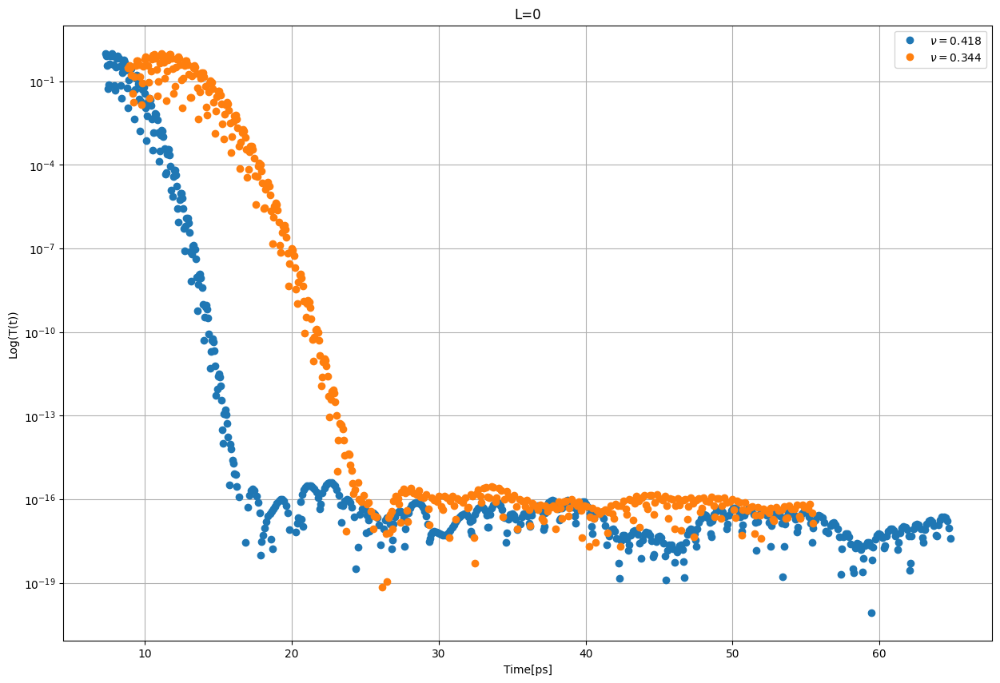

1


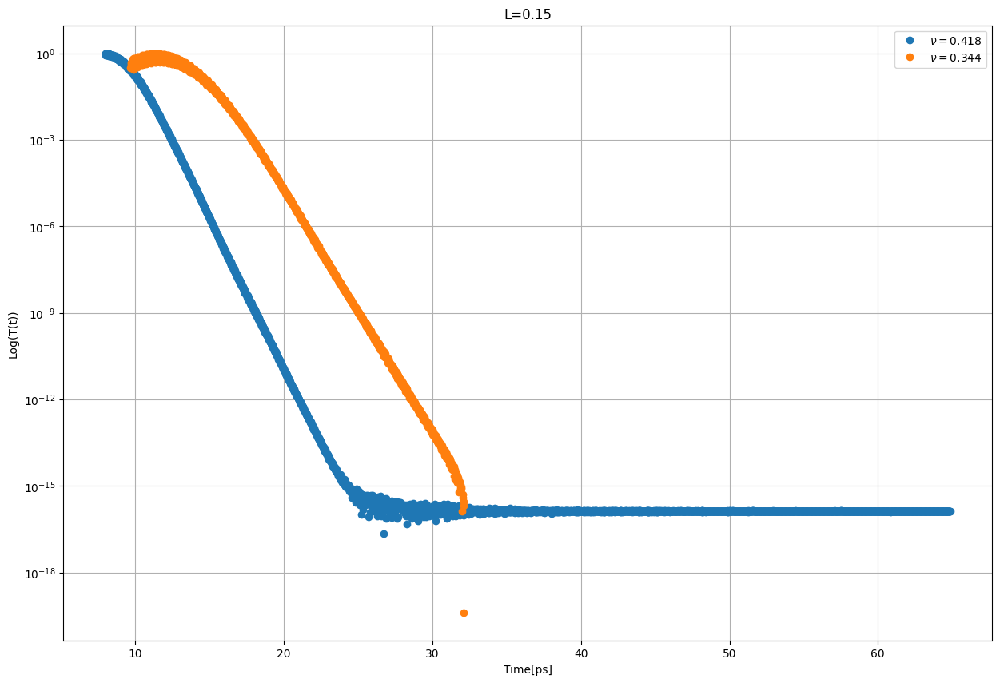

2


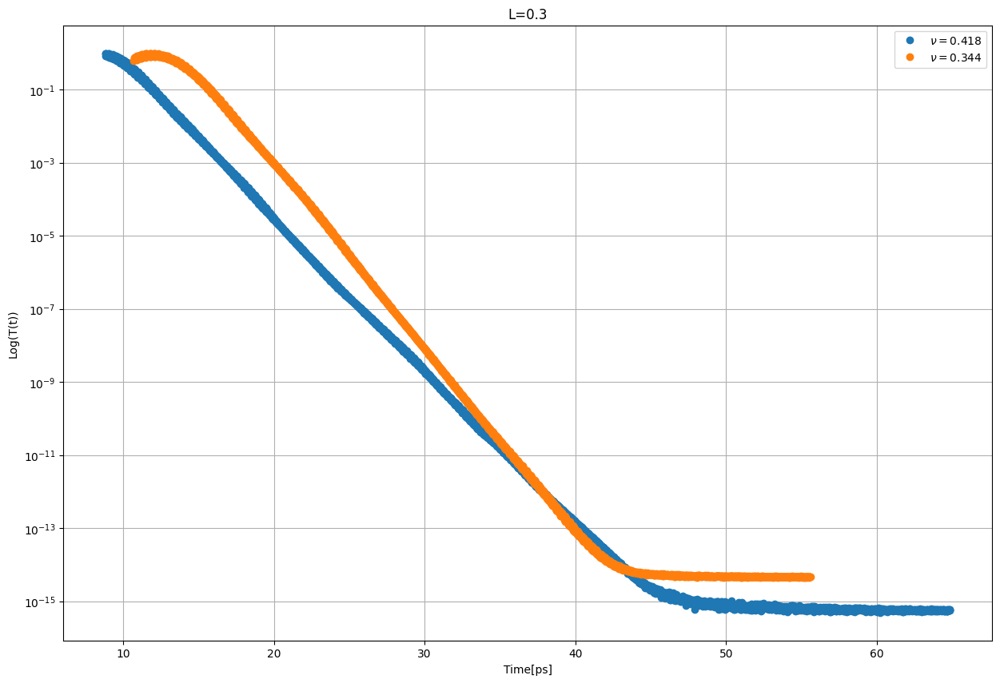

3


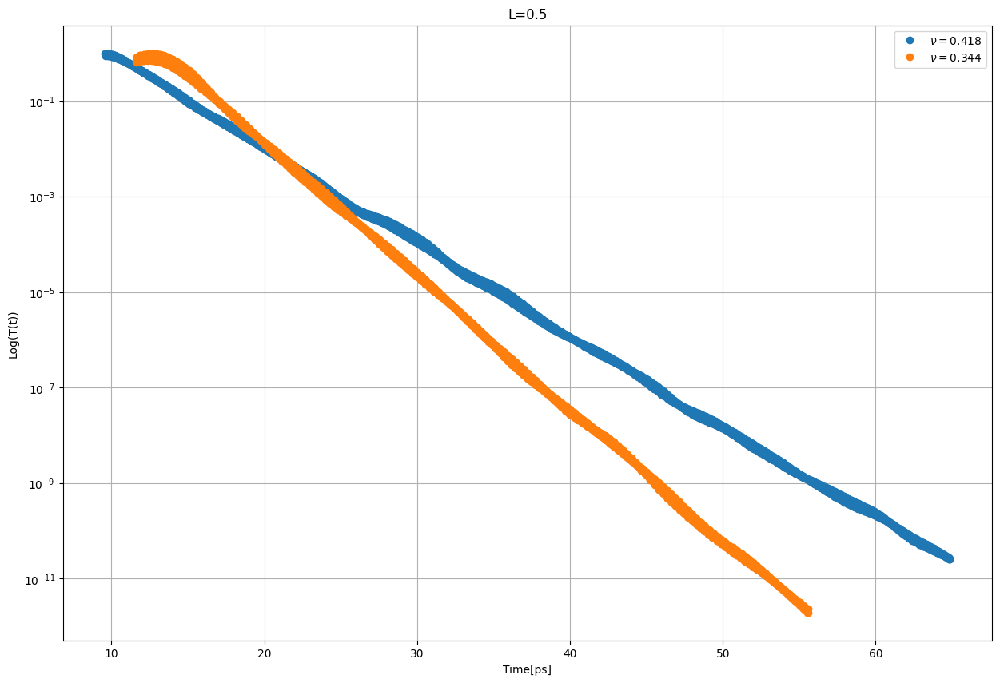

4


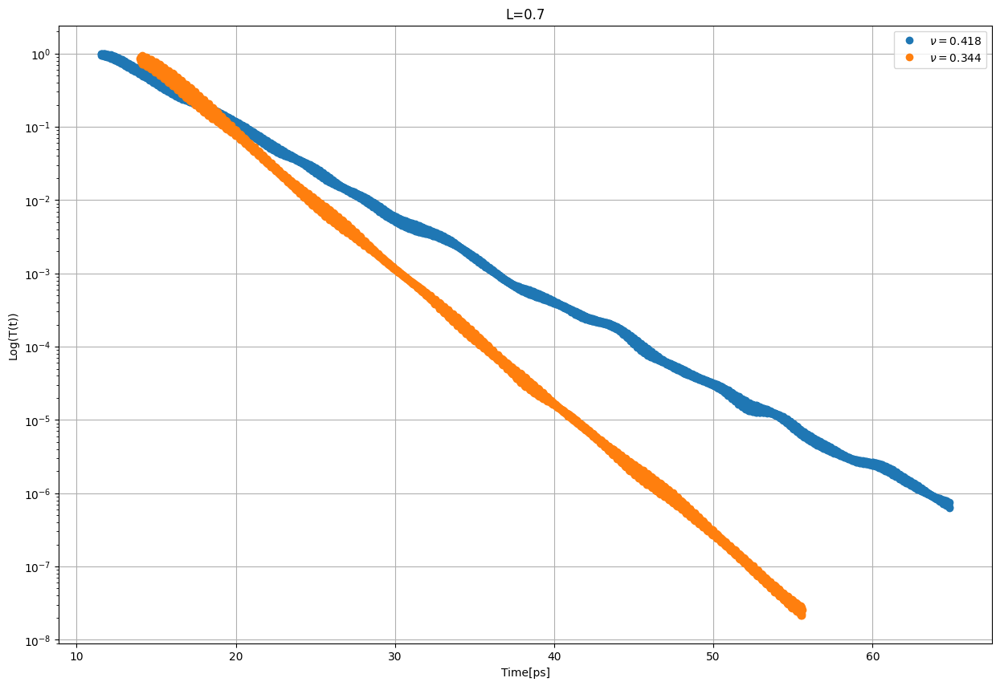

In [4]:
for i,item in enumerate(fluxes_SAL):
    max_index = fluxes_SAL[i]['max_time_index']
    plt.figure(figsize=(15, 10))
    print(i)
    plt.plot(fluxes_SAL[i]['times'][max_index:],fluxes_SAL[i]["flux"][max_index:],"o",label=r"$\nu=0.418$")
    try:
        plt.plot(fluxes_Diff[i]['times'][max_index:],fluxes_Diff[i]["flux"][max_index:],"o",label=r"$\nu=0.344$")
    except:
        False
    plt.title(f"L={slices[i]:.3g}")
    plt.ylabel("Log(T(t))")
    plt.xlabel("Time[ps]")
    plt.yscale("log")
    plt.legend()
    plt.grid()
    plt.show()
          
               








In [5]:
#Anderson
def alpha_star(Db,xi,L):
    return (Db/xi**2)*np.exp(-L/xi)

def trans_t(t,alpha,z0,L,D,td,p=0.5,s=0.85): 
    
    A = ((L+2*z0)**2/np.pi**2)
   

    B = (alpha*td)**(s+1)*np.exp(-alpha*t+1)*(t*alpha)**-(p+1)

    return B**(D*td/A)

In [6]:
#Anderson


Db = lambda l:3e2*l/3
a=5/3
l = np.array([1.12])*a #fitted value 
z0 = 3.25*a
nu = 0.418


#Let's calculate  adjusted values
k =  2*np.pi*(nu/(a))

kl = k*l/4.1
l_adjusted = kl/k
Db1 = Db(l_adjusted)
adjusted_xi = 6*l_adjusted*(k*l_adjusted)**2/(1-(k*l_adjusted)**4)

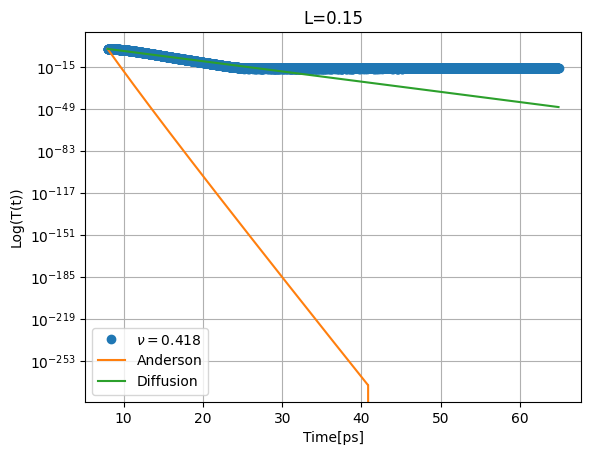

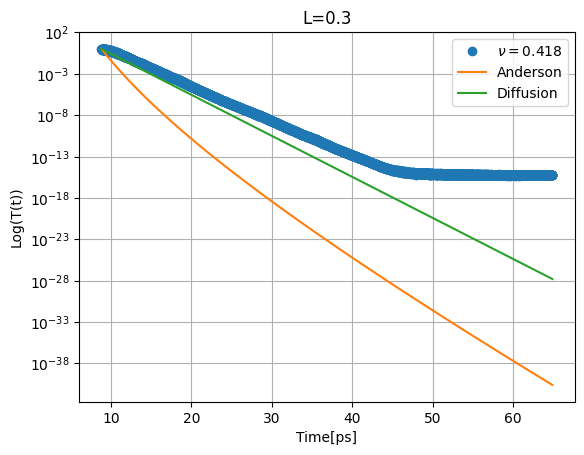

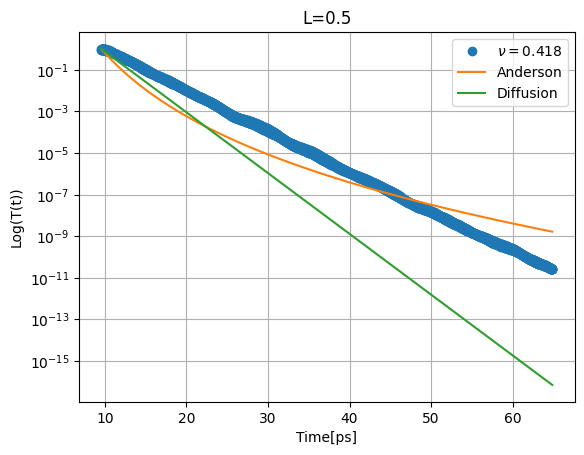

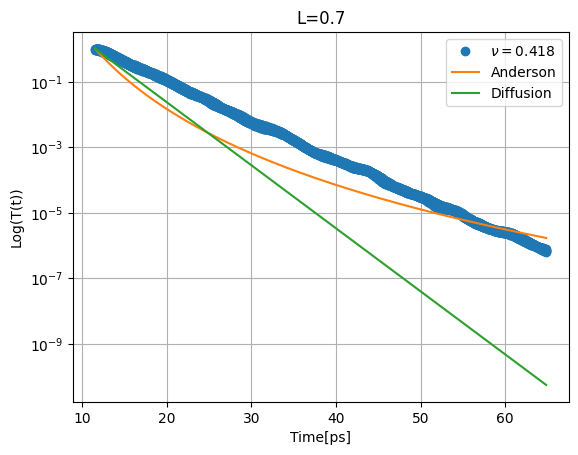

In [7]:
for i,item in enumerate(fluxes_SAL):
    max_index = fluxes_SAL[i]['max_time_index']
    if i == 0:
        continue
    #plt.figure(figsize=(15, 10))
    plt.plot(fluxes_SAL[i]['times'][max_index:],fluxes_SAL[i]["flux"][max_index:],"o",label=r"$\nu=0.418$")
    #Theory#########################################################################
    if i>0:
        L = 18.01*slices[i]*a
        alpha = alpha_star(Db1,adjusted_xi,L)
        transmission_anderson = trans_t(fluxes_SAL[i]['times'][max_index:],alpha,z0,L,Db1,fluxes_SAL[i]['times'][max_index])
        transmission_diffusive = (np.exp(-(fluxes_SAL[i]['times'][max_index:])*(Db1)*(np.pi**2)/(L + 2*z0)**2))
        plt.plot(fluxes_SAL[i]['times'][max_index:],transmission_anderson/np.max(transmission_anderson),label="Anderson")
        plt.plot(fluxes_SAL[i]['times'][max_index:],transmission_diffusive/np.max(transmission_diffusive),label="Diffusion")
    #################################################################################    
    plt.title(f"L={slices[i]:.3g}")
    plt.ylabel("Log(T(t))")
    plt.xlabel("Time[ps]")
    plt.yscale("log")
    plt.legend()
    plt.grid()
    plt.show()
          
               








In [8]:
#Diff
a=5/3
z0 = 3.25*a
nu = 0.344


#Let's calculate  adjusted values
k =  2*np.pi*(nu/(a))

kl = 4.5/4.1
l_adjusted = kl/k
Db1 = Db(l_adjusted)
adjusted_xi = 6*l_adjusted*(k*l_adjusted)**2/(1-(k*l_adjusted)**4)

def diffusion(t,l,L):
    diff = np.exp(-t*Db(l)*np.pi**2/(L+2*z0)**2)
    return diff/np.max(diff)

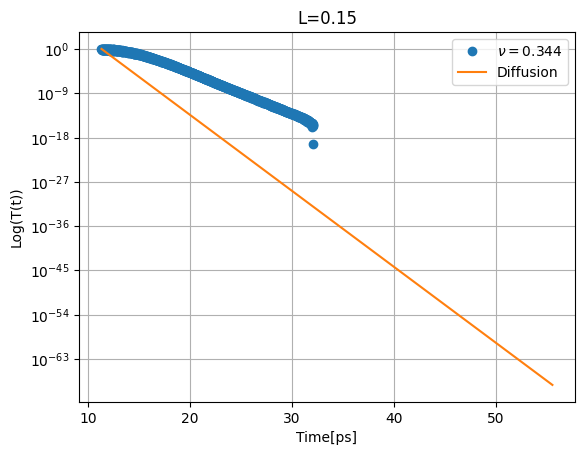

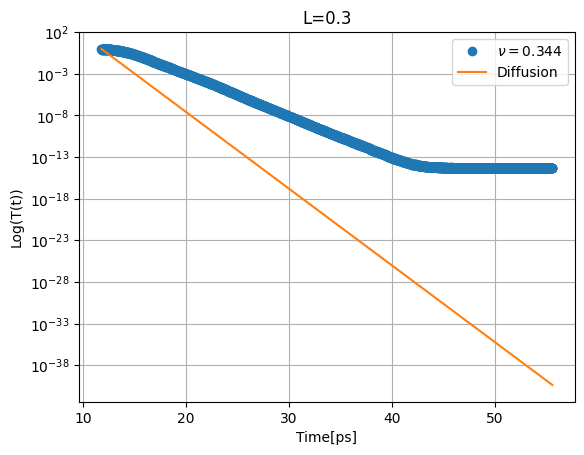

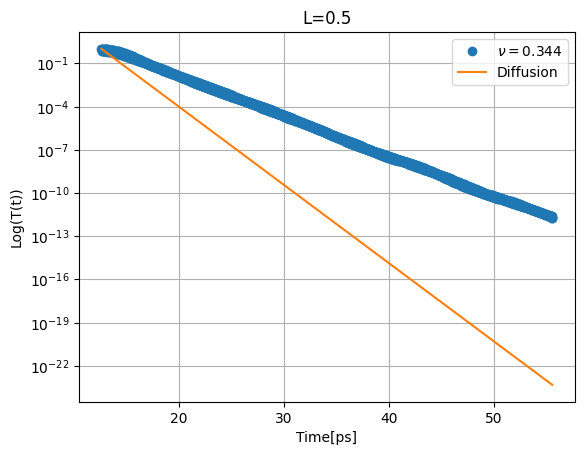

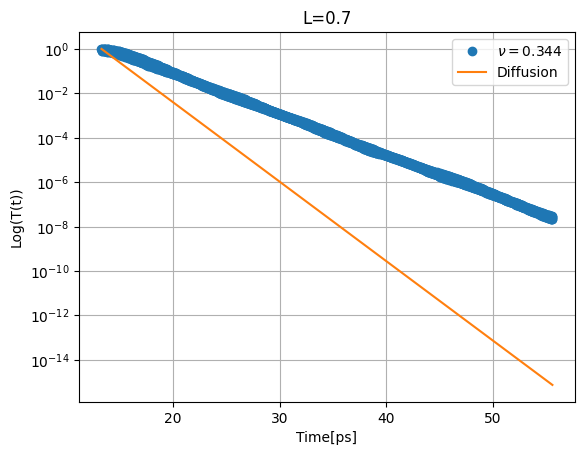

In [9]:
for i,item in enumerate(fluxes_Diff):
    max_index = fluxes_Diff[i]['max_time_index']
    if i == 0:
        continue
    #plt.figure(figsize=(15, 10))
    plt.plot(fluxes_Diff[i]['times'][max_index:],fluxes_Diff[i]["flux"][max_index:],"o",label=r"$\nu=0.344$")
    #Theory#########################################################################
    if i>0:
        L = 18.01*slices[i]*a
        transmission_diffusive = diffusion(fluxes_Diff[i]['times'][max_index:],l_adjusted,L)
        plt.plot(fluxes_Diff[i]['times'][max_index:],transmission_diffusive,label="Diffusion")
    #################################################################################    
    plt.title(f"L={slices[i]:.3g}")
    plt.ylabel("Log(T(t))")
    plt.xlabel("Time[ps]")
    plt.yscale("log")
    plt.legend()
    plt.grid()
    plt.show()
          
               








In [10]:
import jax
import jax.numpy as jnp
from jaxopt import ScipyMinimize
import jaxopt
import matplotlib.pyplot as plt
jax.config.update("jax_enable_x64", True)

def diffusion_jax(t,l,L):
    diff = jnp.exp(-t*Db(l)*jnp.pi**2/(L+2*z0)**2)
    return diff/jnp.max(diff)

In [11]:
jax.default_backend()

'cpu'

c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\core.py:678: FutureWarning: unhashable type: <class 'jax._src.interpreters.partial_eval.DynamicJaxprTracer'>. Attempting to hash a tracer will lead to an error in a future JAX release.
  warnings.warn(


INFO: jaxopt.ZoomLineSearch: Iter: 1 Minimum Decrease & Curvature Errors (stop. crit.): 6.90073793521151e-05 Stepsize:1.0  Decrease Error:0.0  Curvature Error:6.90073793521151e-05 
INFO: jaxopt.ZoomLineSearch: Iter: 1 Minimum Decrease & Curvature Errors (stop. crit.): 0.002826287862653671 Stepsize:1.0  Decrease Error:0.002826287862653671  Curvature Error:0.0 
INFO: jaxopt.ZoomLineSearch: Iter: 2 Minimum Decrease & Curvature Errors (stop. crit.): 0.0017292139774359554 Stepsize:0.5  Decrease Error:0.0017292139774359554  Curvature Error:0.0 
INFO: jaxopt.ZoomLineSearch: Iter: 3 Minimum Decrease & Curvature Errors (stop. crit.): 0.0009700048284106734 Stepsize:0.25  Decrease Error:0.0009700048284106734  Curvature Error:0.0 
INFO: jaxopt.ZoomLineSearch: Iter: 4 Minimum Decrease & Curvature Errors (stop. crit.): 0.0005158635405627665 Stepsize:0.125  Decrease Error:0.0005158635405627665  Curvature Error:0.0 
INFO: jaxopt.ZoomLineSearch: Iter: 5 Minimum Decrease & Curvature Errors (stop. crit.)

XlaRuntimeError: INTERNAL: Generated function failed: CpuCallback error: Traceback (most recent call last):
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\ipykernel_launcher.py", line 18, in <module>
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\traitlets\config\application.py", line 1075, in launch_instance
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\ipykernel\kernelapp.py", line 739, in start
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\tornado\platform\asyncio.py", line 205, in start
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\asyncio\base_events.py", line 641, in run_forever
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\asyncio\base_events.py", line 1987, in _run_once
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\asyncio\events.py", line 88, in _run
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\ipykernel\kernelbase.py", line 545, in dispatch_queue
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\ipykernel\kernelbase.py", line 534, in process_one
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\ipykernel\kernelbase.py", line 437, in dispatch_shell
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\ipykernel\ipkernel.py", line 362, in execute_request
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\ipykernel\kernelbase.py", line 778, in execute_request
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\ipykernel\ipkernel.py", line 449, in do_execute
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\ipykernel\zmqshell.py", line 549, in run_cell
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py", line 3075, in run_cell
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py", line 3130, in _run_cell
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\IPython\core\async_helpers.py", line 129, in _pseudo_sync_runner
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py", line 3334, in run_cell_async
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py", line 3517, in run_ast_nodes
  File "C:\Users\HernandF\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py", line 3577, in run_code
  File "C:\Users\HernandF\AppData\Local\Temp\ipykernel_33644\1206906511.py", line 19, in <module>
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jaxopt\_src\base.py", line 359, in run
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jaxopt\_src\implicit_diff.py", line 251, in wrapped_solver_fun
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\traceback_util.py", line 179, in reraise_with_filtered_traceback
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\custom_derivatives.py", line 622, in __call__
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\custom_derivatives.py", line 813, in bind
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\core.py", line 945, in process_custom_vjp_call
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\linear_util.py", line 192, in call_wrapped
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jaxopt\_src\implicit_diff.py", line 207, in solver_fun_flat
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jaxopt\_src\base.py", line 326, in _run
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jaxopt\_src\loop.py", line 82, in while_loop
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jaxopt\_src\loop.py", line 60, in _while_loop_lax
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\traceback_util.py", line 179, in reraise_with_filtered_traceback
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\lax\control_flow\loops.py", line 1352, in while_loop
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\core.py", line 2834, in bind
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\core.py", line 420, in bind_with_trace
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\core.py", line 921, in process_primitive
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\dispatch.py", line 87, in apply_primitive
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\traceback_util.py", line 179, in reraise_with_filtered_traceback
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\pjit.py", line 327, in cache_miss
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\pjit.py", line 185, in _python_pjit_helper
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\core.py", line 2834, in bind
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\core.py", line 420, in bind_with_trace
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\core.py", line 921, in process_primitive
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\pjit.py", line 1635, in _pjit_call_impl
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\pjit.py", line 1614, in call_impl_cache_miss
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\pjit.py", line 1568, in _pjit_call_impl_python
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\profiler.py", line 335, in wrapper
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\interpreters\pxla.py", line 1244, in __call__
  File "c:\Users\HernandF\AppData\Local\Programs\Python\Python312\Lib\site-packages\jax\_src\interpreters\mlir.py", line 2528, in _wrapped_callback
KeyboardInterrupt: 

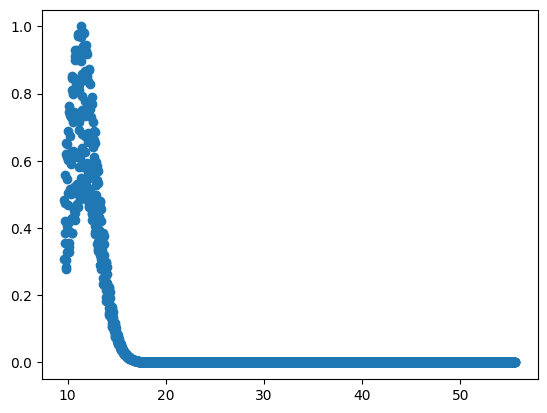

In [12]:
for i,item in enumerate(fluxes_Diff):
    if i==0:
        continue
    max_index = fluxes_SAL[i]['max_time_index']
    #plt.figure(figsize=(15, 10))
    plt.plot(fluxes_Diff[i]['times'][max_index:],fluxes_Diff[i]["flux"][max_index:],"o",label=r"$\nu=0.344$")
    #Theory#########################################################################
    if i>0:
        L = 18.01*slices[i]*a
        #popt,_ = curve_fit(lambda t,l:diffusion(t,l,L),fluxes_Diff[i]['times'][max_index:],fluxes_Diff[i]["flux"][max_index:],l_adjusted)
        model = lambda l,t:diffusion_jax(t,l[0],L)
        def loss_fn(params):
         y_pred = model(params, fluxes_Diff[i]['times'][max_index:])
         return jnp.mean((y_pred - fluxes_Diff[i]["flux"][max_index:])**2)
        
        initial_params = jnp.array([0.45], dtype=jnp.float32)
        optimizer = jaxopt.BFGS(fun=loss_fn,maxiter=10000)
        # Optimize the parameters
        result = optimizer.run(initial_params)
        optimal_params = result.params

        print(optimal_params)

        transmission_diffusive = diffusion(fluxes_Diff[i]['times'][max_index:],optimal_params[0],L)
        plt.plot(fluxes_Diff[i]['times'][max_index:],transmission_diffusive,label="Diffusion")
    #################################################################################    
    plt.title(f"L={slices[i]:.3g}")
    plt.ylabel("Log(T(t))")
    plt.xlabel("Time[ps]")
    plt.yscale("log")
    plt.legend()
    plt.grid()
    plt.show()
          
               








In [ ]:
#Anderson
def alpha_star(Db,xi,L):
    return (Db/xi**2)*jnp.exp(-L/xi)

def trans_t(t,alpha,z0,L,D,td,p=0.5,s=0.85): 
    
    A = ((L+2*z0)**2/jnp.pi**2)
   

    B = (alpha*td)**(s+1)*jnp.exp(-alpha*t+1)*(t*alpha)**-(p+1)

    return B**(D*td/A)

#Anderson


Db = lambda l:3e2*l/3
a=5/3
l = np.array([1.12])*a #fitted value 
z0 = 3.25*a
nu = 0.418


#Let's calculate  adjusted values
k =  2*np.pi*(nu/(a))

kl = k*l/4.1
l_adjusted = kl/k
Db1 = Db(l_adjusted)
adjusted_xi = 6*l_adjusted*(k*l_adjusted)**2/(1-(k*l_adjusted)**4)

In [ ]:
def transmission_anderson_func_jax(t,l,z0,nu,L,td,s,p):
    Db_calculated = Db(l)
    k =  2*jnp.pi*(nu/(a))
    xi = 6*l*(k*l)**2/(1-(k*l)**4)
    alpha= alpha_star(Db_calculated,xi,L)
    transmission = trans_t(t,alpha,z0,L,Db_calculated,td,p,s)
    return jnp.log((transmission)/(jnp.max(transmission)))

In [ ]:

###########Fitting procedure###################
for i,item in enumerate(fluxes_SAL):
    max_index = fluxes_SAL[i]['max_time_index']
    #plt.figure(figsize=(15, 10))
    if i in [0,1,2]:
       continue
    plt.plot(fluxes_SAL[i]['times'][max_index:],jnp.log(fluxes_SAL[i]["flux"][max_index:]),"o",label=r"$\nu=0.418$")
    #Theory#########################################################################
    if i>0:
        L = 18.01*slices[i]*a
        # p0 =[0.45528455]
        # popt,_ = curve_fit(lambda t,l: transmission_anderson_func(t,l,z0,0.418,L,fluxes_SAL[i]['times'][max_index],0.85,0.5),fluxes_SAL[i]['times'][max_index:],fluxes_SAL[i]["flux"][max_index:],p0,maxfev = 5000)
        model = lambda params,t: transmission_anderson_func_jax(t,params[0],params[3],0.418,L,fluxes_SAL[i]['times'][max_index],params[1],params[2])
        def loss_fn(params):
         y_pred = model(params, fluxes_Diff[i]['times'][max_index:])
         return jnp.mean((y_pred - jnp.log(fluxes_Diff[i]["flux"][max_index:]))**2)
        
        initial_params = jnp.array([l_adjusted[0],0.85,0.5,z0], dtype=jnp.float32)
        optimizer = jaxopt.ScipyMinimize(fun=loss_fn,maxiter=15000)
        # Optimize the parameters
        result = optimizer.run(initial_params)
        optimal_params = result.params

        print(optimal_params)

        transmission_anderson = transmission_anderson_func_jax(fluxes_SAL[i]['times'][max_index:],optimal_params[0],optimal_params[3],0.418,L,fluxes_SAL[i]['times'][max_index],optimal_params[1],optimal_params[2])
        #transmission_diffusive = (np.exp(-(fluxes_SAL[i]['times'][max_index:])*(Db1)*(np.pi**2)/(L + 2*z0)**2))
        plt.plot(fluxes_SAL[i]['times'][max_index:],transmission_anderson,label="Anderson")
        #plt.plot(fluxes_SAL[i]['times'][max_index:],transmission_diffusive/np.max(transmission_diffusive),label="Diffusion")
    #################################################################################    
    plt.title(f"L={slices[i]:.3g}")
    plt.ylabel("Log(T(t))")
    plt.xlabel("Time[ps]")
    #plt.yscale("log")
    plt.legend()
    plt.grid()
    plt.show()
          
               






